In [277]:
import numpy as np
import pandas as pd
from scipy.stats import multivariate_normal
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure
from math import pi
import random
from sklearn.datasets import make_classification
from sklearn.preprocessing import MinMaxScaler
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.utils.estimator_checks import check_estimator
from sklearn.utils.validation import check_X_y, check_array, check_is_fitted
from sklearn.utils.multiclass import unique_labels
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from mlxtend.plotting import plot_decision_regions
from sklearn.base import BaseEstimator, ClassifierMixin
from sklearn.utils.estimator_checks import check_estimator
from sklearn.utils.validation import check_X_y, check_array, check_is_fitted
from sklearn.utils.multiclass import unique_labels
from sklearn.naive_bayes import MultinomialNB
from sklearn.pipeline import make_pipeline
from sklearn.metrics import accuracy_score, mean_squared_error
from sklearn.feature_extraction.text import CountVectorizer, ENGLISH_STOP_WORDS
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV
import re
import math as m


In [278]:
#dataset import
#what i need:
#Host star name
#planet name
#planet orbit longest radius
#planet orbit eccentricity
#star brightness (magnitude)
#star distance frome earth in parse
#star spectral type
#relase date
df = pd.read_csv("original_set.csv")
df_alpha = df[["pl_name","hostname","pl_orbsmax","pl_orbeccen","sy_vmag","sy_dist","st_spectype","releasedate"]]
#update records
df_alpha = df_alpha.sort_values('releasedate').drop_duplicates('pl_name',keep='last')


df_alpha['st_spectype'] = df_alpha['st_spectype'].fillna('0')
df_alpha['pl_orbeccen'] = df_alpha['pl_orbeccen'].fillna(0)
df_alpha['st_spectype'] = df_alpha['st_spectype'].astype(str).str[0]
df_alpha = df_alpha.dropna()
df_alpha['st_spectype'].replace(['m'], ['M'], inplace=True)
df_alpha['st_spectype'].replace(['W'], ['0'], inplace=True)
df_alpha = df_alpha.drop(columns=['releasedate'])

bc_dict = {'G':-0.4, 'K':-0.8, '0':0, 'A':-0.3, 'M':-2.0, 'B':-2.0, 'F':-0.15}
df_alpha['absolute_magnitude'] = df_alpha['sy_vmag'] - 5*np.log10(df_alpha['sy_dist']/10)
df_alpha['bolometric_magnitude'] = df_alpha['absolute_magnitude'] + df_alpha['st_spectype'].replace(bc_dict)
df_alpha['luminosity'] = 10**((df_alpha['bolometric_magnitude']-4.72)/-2.5)
df_alpha['habitalbe_zone_inner'] = np.sqrt(df_alpha['luminosity']/1.1)
df_alpha['habitalbe_zone_outer'] = np.sqrt(df_alpha['luminosity']/0.53)
df_alpha['pl_orbsmin'] = df_alpha['pl_orbsmax']*np.sqrt(1-df_alpha['pl_orbeccen']**2)
df_alpha['pl_orbsfocus'] = df_alpha['pl_orbsmax']*df_alpha['pl_orbeccen']

df_beta = df_alpha[["pl_name","hostname","pl_orbsmax","pl_orbsmin","pl_orbsfocus","habitalbe_zone_inner","habitalbe_zone_outer"]]

display(df_beta)

,pl_name,hostname,pl_orbsmax,pl_orbsmin,pl_orbsfocus,habitalbe_zone_inner,habitalbe_zone_outer
31169,TYC 1422-614-1 b,TYC 1422-614-1,0.69000,0.688757,0.04140,5.156296,7.428416
31170,TYC 1422-614-1 c,TYC 1422-614-1,1.37000,1.368421,0.06576,5.156296,7.428416
31923,WASP-94 B b,WASP-94 B,0.03350,0.033500,0.00000,1.428952,2.058620
22829,Kepler-424 c,Kepler-424,0.73000,0.730000,0.00000,0.761659,1.097284
2778,HIP 97233 b,HIP 97233,2.55000,2.020624,1.55550,4.217675,6.076193
...,...,...,...,...,...,...,...
31038,TOI-2445 b,TOI-2445,0.00640,0.006400,0.00000,0.029606,0.042652
31410,WASP-151 b,WASP-151,0.05500,0.055000,0.00000,1.035850,1.492297
516,GJ 3929 b,GJ 3929,0.02569,0.025690,0.00000,0.097101,0.139888
30985,TOI-1759 b,TOI-1759,0.11760,0.117600,0.00000,0.138062,0.198899


In [332]:
def star_map(stars):
    t = np.linspace(0, 2*pi, 100)
    tem = stars["hostname"].iloc[[0]].to_string(index=False)
    id = 1
    max_orb = 0
    for i in range(len(stars)):
        if(id == 1):
            id = 0
            hro = float(stars["habitalbe_zone_outer"].iloc[[i]].to_string(index=False))
            hri = float(stars["habitalbe_zone_inner"].iloc[[i]].to_string(index=False))
            figure, axes = plt.subplots(figsize=(6,6))
            draw_circle_out = plt.Circle((0, 0), hro, color = 'lightgreen')
            draw_circle_in = plt.Circle((0, 0), hri, color = 'bisque')
            axes.add_patch(draw_circle_out)
            axes.add_patch(draw_circle_in)
            plt.plot(0,0,'o',color='firebrick',markersize=11)
        if(float(stars["pl_orbsmax"].iloc[[i]].to_string(index=False)) > max_orb):
            max_orb = float(stars["pl_orbsmax"].iloc[[i]].to_string(index=False))
        u=float(stars["pl_orbsfocus"].iloc[[i]].to_string(index=False))   #x-position of the center
        v=0                                                  #y-position of the center
        a=float(stars["pl_orbsmax"].iloc[[i]].to_string(index=False))    #radius on the x-axis
        b=float(stars["pl_orbsmin"].iloc[[i]].to_string(index=False))    #radius on the y-axis     
        plt.plot( u + a*np.cos(t), v + b*np.sin(t), color='steelblue' ,linewidth=0.8)
        random_sd = random.random()*2*pi
        plt.plot( u + a*np.cos(random_sd), v + b*np.sin(random_sd),"o",color='steelblue',markersize=7)
        if(i != (len(stars) - 1) and tem != stars["hostname"].iloc[[i+1]].to_string(index=False)):
            plt.xlim(-max_orb*2,max_orb*2)
            plt.ylim(-max_orb*2,max_orb*2)
            plt.title(stars["hostname"].iloc[[i]].to_string(index=False))
            plt.xlabel("Length (AU)")
            plt.ylabel("Length (AU)")
            max_orb = 0
            plt.savefig(stars["hostname"].iloc[[i+1]].to_string(index=False)+".png")
            tem = stars["hostname"].iloc[[i+1]].to_string(index=False)
            id = 1

/home/ec2-user/anaconda3/envs/python3/lib/python3.6/site-packages/ipykernel/__main__.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


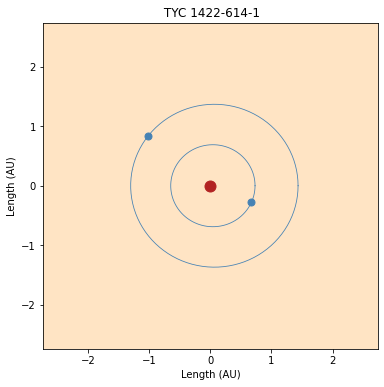

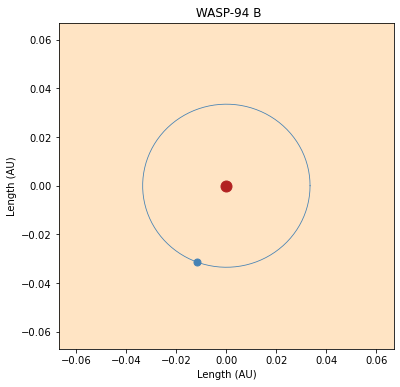

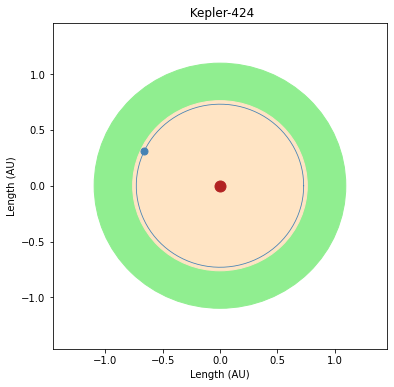

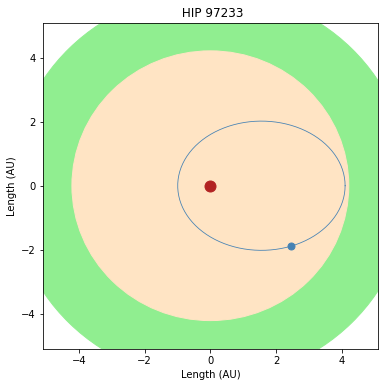

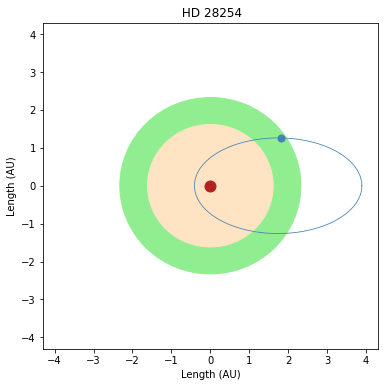

...

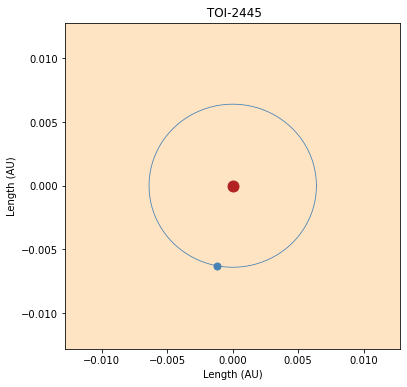

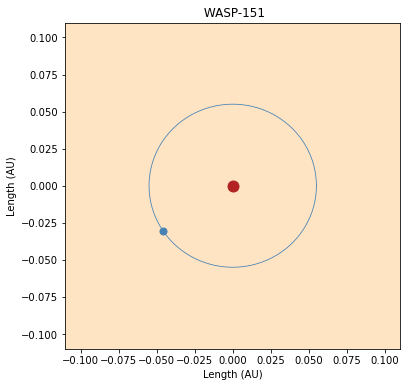

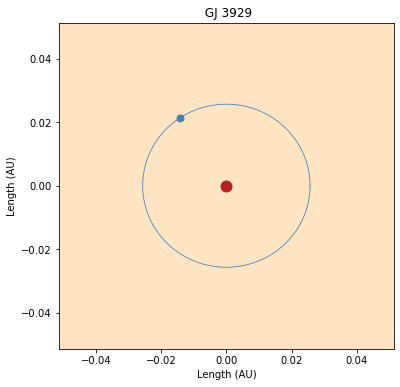

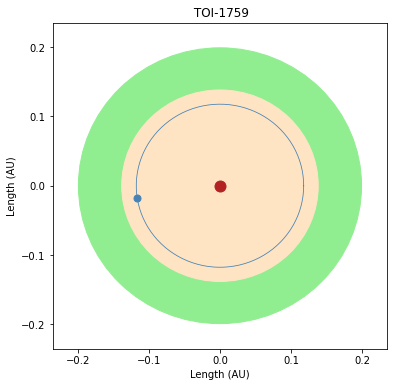

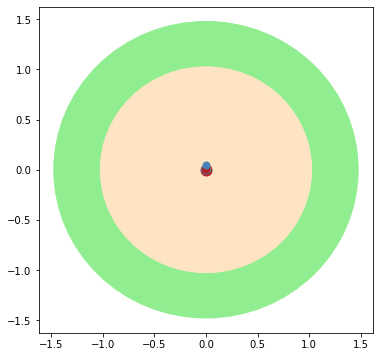

In [333]:
star_map(df_beta)

In [322]:
print("2344"+"sfg")

2344sfg
